<a href="https://colab.research.google.com/github/DILNATHRK/DEEP-LEARNING-PROJECTS/blob/main/EmergencyVehicle_Detection_deep_learning_project1_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
pip install pydot

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import pydot
from IPython.display import SVG
from keras.utils import plot_model
from keras.initializers import glorot_uniform
import scipy.misc
from matplotlib.pyplot import imshow
import pandas as pd
import os
import matplotlib.pyplot as plt
from PIL import Image
from shutil import copyfile
%matplotlib inline

import keras.backend as K
K.set_image_data_format('channels_last')
K.set_learning_phase(1)

/usr/local/lib/python3.8/dist-packages/keras/backend.py:450: UserWarning: `tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.
  warnings.warn('`tf.keras.backend.set_learning_phase` is deprecated and '


In [ ]:
!wget --no-check-certificate \
    https://storage.googleapis.com/mledu-datasets/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5 \
    -O /tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5

--2023-01-13 16:27:26--  https://storage.googleapis.com/mledu-datasets/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5
Resolving storage.googleapis.com (storage.googleapis.com)... 142.250.145.128, 108.177.127.128, 172.217.218.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|142.250.145.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 87910968 (84M) [application/x-hdf]
Saving to: ‘/tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5’

/tmp/inception_v3_w 100%[===================>]  83.84M  26.3MB/s    in 3.4s    

2023-01-13 16:27:29 (24.8 MB/s) - ‘/tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5’ saved [87910968/87910968]



In [ ]:
!unzip /content/drive/MyDrive/masterfolder/train_SOaYf6m.zip

Archive:  /content/drive/MyDrive/masterfolder/train_SOaYf6m.zip
   creating: unzip/
   creating: unzip/images/
  inflating: unzip/images/0.jpg      
  inflating: unzip/images/1.jpg      
  inflating: unzip/images/10.jpg     
  inflating: unzip/images/100.jpg    
  inflating: unzip/images/1000.jpg   
  inflating: unzip/images/1001.jpg   
  inflating: unzip/images/1002.jpg   
  inflating: unzip/images/1003.jpg   
  inflating: unzip/images/1004.jpg   
  inflating: unzip/images/1005.jpg   
  inflating: unzip/images/1006.jpg   
  inflating: unzip/images/1007.jpg   
  inflating: unzip/images/1008.jpg   
  inflating: unzip/images/1009.jpg   
  inflating: unzip/images/101.jpg    
  inflating: unzip/images/1010.jpg   
  inflating: unzip/images/1011.jpg   
  inflating: unzip/images/1012.jpg   
  inflating: unzip/images/1013.jpg   
  inflating: unzip/images/1014.jpg   
  inflating: unzip/images/1015.jpg   
  inflating: unzip/images/1016.jpg   
  inflating: unzip/images/1017.jpg   
  inflating: un

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/masterfolder/train.csv')
df.head()

,image_names,emergency_or_not
0,1503.jpg,0
1,1420.jpg,0
2,1764.jpg,0
3,1356.jpg,0
4,1117.jpg,0


In [ ]:
df.shape

(1646, 2)

In [ ]:
df['emergency_or_not'].value_counts()

0    965
1    681
Name: emergency_or_not, dtype: int64

(224, 224)


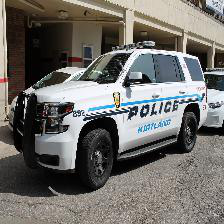

In [ ]:
sample_image = '/content/unzip/images/45.jpg'
img1 = Image.open(sample_image)
print(img1.size)
img1


In [ ]:
# for e in ['emergency', 'non_emergency']:
#   os.makedirs(f'/content/drive/MyDrive/masterfolder/training/{e}')
#   os.makedirs(f'/content/drive/MyDrive/masterfolder/validation/{e}')

In [ ]:
for row in df.head(10).itertuples():
  print(row.image_names, row.emergency_or_not, type(row.emergency_or_not))

1503.jpg 0 <class 'int'>
1420.jpg 0 <class 'int'>
1764.jpg 0 <class 'int'>
1356.jpg 0 <class 'int'>
1117.jpg 0 <class 'int'>
45.jpg 1 <class 'int'>
2313.jpg 0 <class 'int'>
1657.jpg 0 <class 'int'>
294.jpg 1 <class 'int'>
999.jpg 0 <class 'int'>


## Separate images into training and validation directories

In [ ]:
# for row in df.itertuples():
#   src = f'images/{row.image_names}'
#   prob = np.random.randint(0,10)
#   typ = '/content/drive/MyDrive/masterfolder/training' if 0 <= prob < 8 else '/content/drive/MyDrive/masterfolder/validation'
#   label = '/emergency' if row.emergency_or_not else '/non_emergency'
#   dst = f'{typ}/{label}/{row.image_names}'
#   copyfile(src, dst)

In [ ]:
print(len(os.listdir('/content/drive/MyDrive/masterfolder/training/emergency')))
print(len(os.listdir('/content/drive/MyDrive/masterfolder/training/non_emergency')))
print(len(os.listdir('/content/drive/MyDrive/masterfolder/validation/emergency')))
print(len(os.listdir('/content/drive/MyDrive/masterfolder/validation/non_emergency')))

555
782
131
183


In [ ]:
train_dir = '/content/drive/MyDrive/masterfolder/training'
validation_dir = '/content/drive/MyDrive/masterfolder/validation'

train_emergency_dir = '/content/drive/MyDrive/masterfolder/training/emergency'
train_non_emergency_dir = '/content/drive/MyDrive/masterfolder/training/non_emergency'
validation_emergency_dir = '/content/drive/MyDrive/masterfolder/validation/emergency'
validation_non_emergency_dir = '/content/drive/MyDrive/masterfolder/validation/non_emergency'

In [ ]:
train_datagen = ImageDataGenerator(
    rescale = 1.0/255.0,
    rotation_range = 20,
    width_shift_range = 0.2,
    height_shift_range = 0.2,
    shear_range = 0.2,
    zoom_range = 0.2,
    horizontal_flip = True
)

validation_datagen = ImageDataGenerator(rescale=1./255.0)

In [ ]:
train_generator = train_datagen.flow_from_directory(
    train_dir,
    batch_size=16,
    target_size=(224,224),
    class_mode='binary'
)

validation_generator = validation_datagen.flow_from_directory(
    validation_dir,
    batch_size=16,
    target_size=(224,224),
    class_mode='binary',
    shuffle=False
)

Found 1337 images belonging to 2 classes.
Found 314 images belonging to 2 classes.


In [ ]:
print(train_generator.class_indices)

{'emergency': 0, 'non_emergency': 1}


In [ ]:
print(validation_generator.class_indices)

{'emergency': 0, 'non_emergency': 1}


## Visualise the images

In [ ]:
sample_training_images, _ = next(train_generator)

In [ ]:
def plotImages(images_arr):
    fig, axes = plt.subplots(1, 5, figsize=(20,20))
    axes = axes.flatten()
    for img, ax in zip( images_arr, axes):
        ax.imshow(img)
        ax.axis('off')
    plt.tight_layout()
    plt.show()

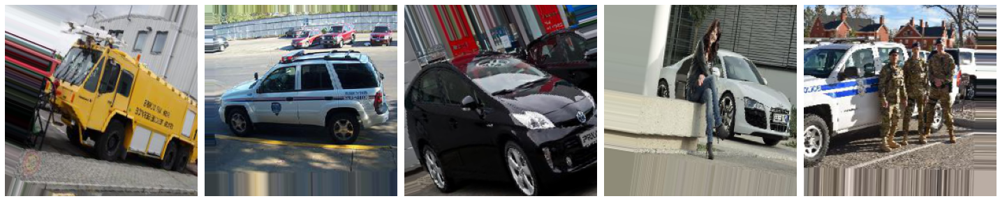

In [ ]:
plotImages(sample_training_images[:5])

MODEL CREATION

In [ ]:
path_inception = "/tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5"

from tensorflow.keras.applications.inception_v3 import InceptionV3

local_weights_file = path_inception

pre_trained_model = InceptionV3(input_shape = (224, 224, 3), 
                                include_top = False, 
                                weights = None)

pre_trained_model.load_weights(local_weights_file)

# Make all the layers in the pre-trained model non-trainable
for layer in pre_trained_model.layers:
    layer.trainable =True
    
# Print the model summary
pre_trained_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_94 (Conv2D)             (None, 111, 111, 32  864         ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization_94 (BatchN  (None, 111, 111, 32  96         ['conv2d_94[0][0]']              
 ormalization)                  )                                                      

In [ ]:
last_layer = pre_trained_model.get_layer('mixed9')
print('last layer output shape: ', last_layer.output_shape)
last_output = last_layer.output

last layer output shape:  (None, 5, 5, 2048)


In [ ]:
X = tf.keras.layers.Flatten()(last_output)
X = tf.keras.layers.Dense(1024, activation='relu')(X)
X = tf.keras.layers.Dropout(0.2)(X)
X = tf.keras.layers.Dense(512, activation='relu')(X)
X = tf.keras.layers.Dropout(0.2)(X)
X = tf.keras.layers.Dense(1, activation='sigmoid')(X)

In [ ]:
model = Model(pre_trained_model.input, X)
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 111, 111, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 111, 111, 32  96         ['conv2d[0][0]']                 
 alization)                     )                                                             

In [ ]:
EPOCHS = 5

In [ ]:
history = model.fit(
    train_generator,
    validation_data=validation_generator,
    epochs=EPOCHS)

Epoch 1/5
84/84 [==============================] - 512s 6s/step - loss: 0.6475 - accuracy: 0.7210 - val_loss: 1120.2439 - val_accuracy: 0.5510
Epoch 2/5
84/84 [==============================] - 21s 253ms/step - loss: 0.5276 - accuracy: 0.8227 - val_loss: 16.6948 - val_accuracy: 0.7707
Epoch 3/5
84/84 [==============================] - 21s 251ms/step - loss: 0.4227 - accuracy: 0.8347 - val_loss: 0.8403 - val_accuracy: 0.8025
Epoch 4/5
84/84 [==============================] - 23s 269ms/step - loss: 0.3618 - accuracy: 0.8676 - val_loss: 2.1605 - val_accuracy: 0.8153
Epoch 5/5
84/84 [==============================] - 22s 257ms/step - loss: 0.3795 - accuracy: 0.8504 - val_loss: 5.9597 - val_accuracy: 0.6051


In [ ]:
acc = history.history['accuracy']
acc 

[0.7210171818733215,
 0.822737455368042,
 0.834704577922821,
 0.8676140904426575,
 0.8504113554954529]

In [ ]:
epochs_range = range(5)
epochs_range

range(0, 5)

## Error analysis

In [ ]:
val_pred = model.predict(validation_generator)

20/20 [==============================] - 2s 58ms/step


In [ ]:
val_pred = np.rint(val_pred)
val_true = validation_generator.classes

In [ ]:
validation_generator.class_indices

{'emergency': 0, 'non_emergency': 1}

[[ 82  49]
 [ 75 108]]


[Text(0, 0.5, 'emergency'), Text(0, 1.5, 'non_emergency')]

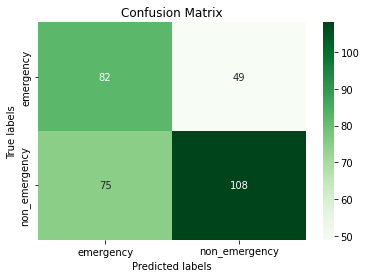

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import cv2

labels=['emergency','non_emergency']
cm = confusion_matrix(val_true, val_pred)
print(cm)
ax = plt.subplot()
sns.heatmap(cm, annot=True, ax=ax, fmt='g', cmap='Greens'); #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(labels)
ax.yaxis.set_ticklabels(labels)

In [ ]:
val_files = validation_generator.filenames
val_files[:10]

['emergency/123.jpg',
 'emergency/144.jpg',
 'emergency/151.jpg',
 'emergency/172.jpg',
 'emergency/180.jpg',
 'emergency/197.jpg',
 'emergency/199.jpg',
 'emergency/206.jpg',
 'emergency/224.jpg',
 'emergency/236.jpg']

**predicted results**

In [ ]:
correct_images = []
correct_labels = []
for i, (true, pred) in enumerate(zip(val_true, val_pred)):
  if true == pred:
    img = cv2.imread(f'/content/drive/MyDrive/masterfolder/validation/{val_files[i]}')
    correct_images.append(img)
    correct_labels.append([true, pred])

correct_images = np.array(correct_images)
correct_images.shape

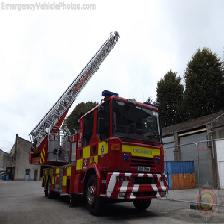

Actual: emergency, Predicted: emergency


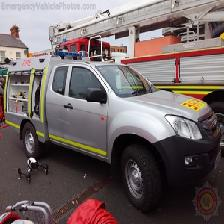

Actual: emergency, Predicted: emergency


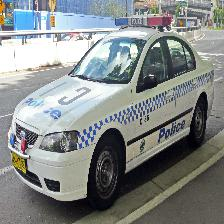

Actual: emergency, Predicted: emergency


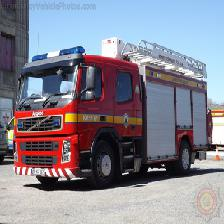

Actual: emergency, Predicted: emergency


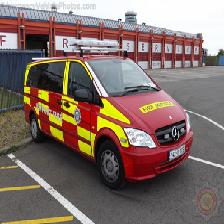

Actual: emergency, Predicted: emergency


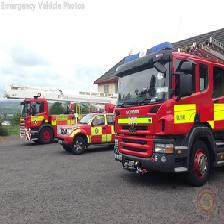

Actual: emergency, Predicted: emergency


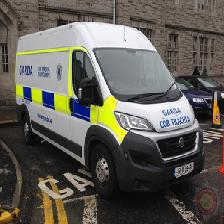

Actual: emergency, Predicted: emergency


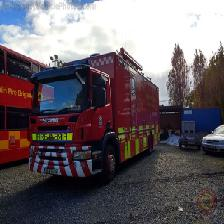

Actual: emergency, Predicted: emergency


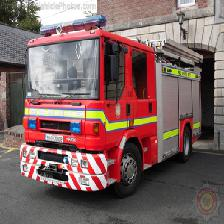

Actual: emergency, Predicted: emergency


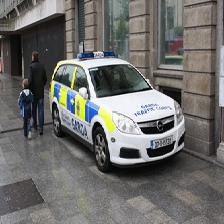

Actual: emergency, Predicted: emergency


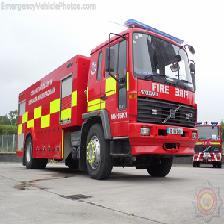

Actual: emergency, Predicted: emergency


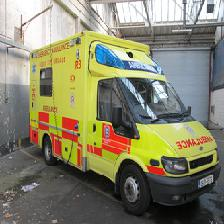

Actual: emergency, Predicted: emergency


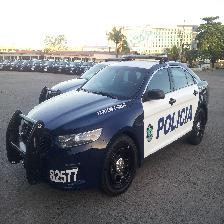

Actual: emergency, Predicted: emergency


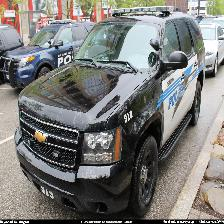

Actual: emergency, Predicted: emergency


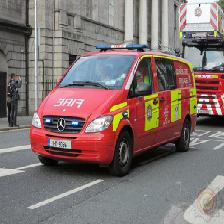

Actual: emergency, Predicted: emergency


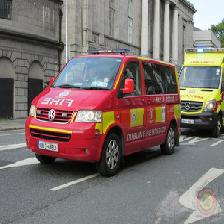

Actual: emergency, Predicted: emergency


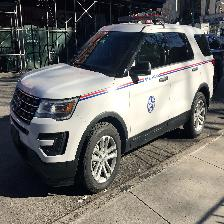

Actual: emergency, Predicted: emergency


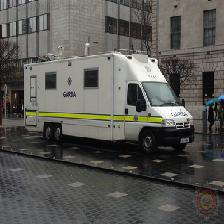

Actual: emergency, Predicted: emergency


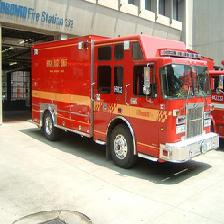

Actual: emergency, Predicted: emergency


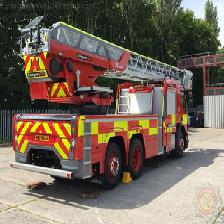

Actual: emergency, Predicted: emergency


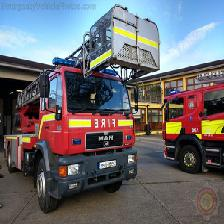

Actual: emergency, Predicted: emergency


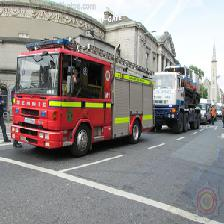

Actual: emergency, Predicted: emergency


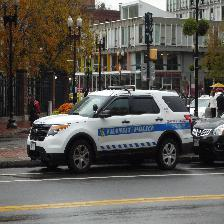

Actual: emergency, Predicted: emergency


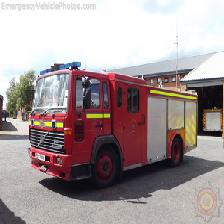

Actual: emergency, Predicted: emergency


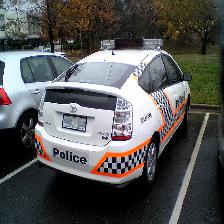

Actual: emergency, Predicted: emergency


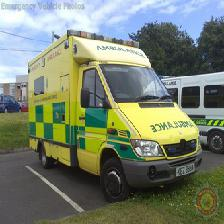

Actual: emergency, Predicted: emergency


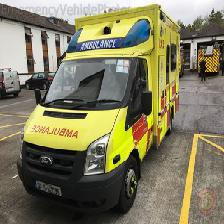

Actual: emergency, Predicted: emergency


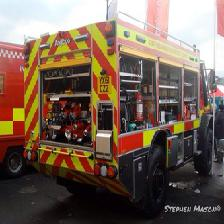

Actual: emergency, Predicted: emergency


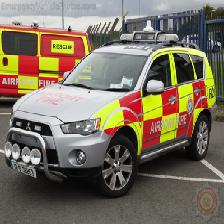

Actual: emergency, Predicted: emergency


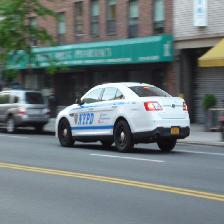

Actual: emergency, Predicted: emergency


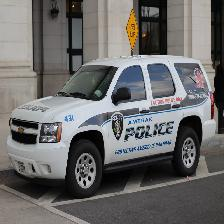

Actual: emergency, Predicted: emergency


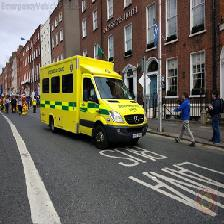

Actual: emergency, Predicted: emergency


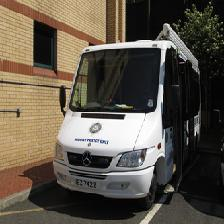

Actual: emergency, Predicted: emergency


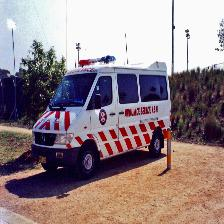

Actual: emergency, Predicted: emergency


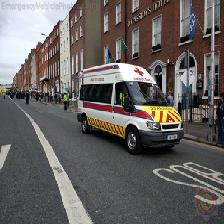

Actual: emergency, Predicted: emergency


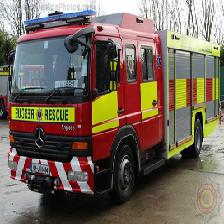

Actual: emergency, Predicted: emergency


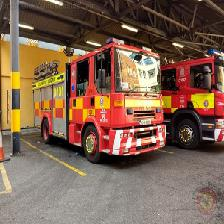

Actual: emergency, Predicted: emergency


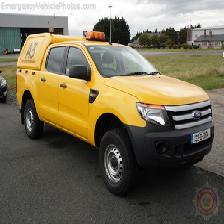

Actual: emergency, Predicted: emergency


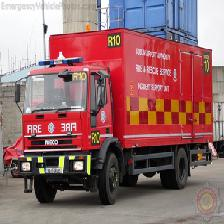

Actual: emergency, Predicted: emergency


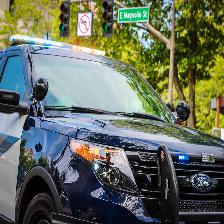

Actual: emergency, Predicted: emergency


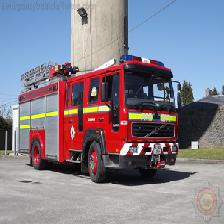

Actual: emergency, Predicted: emergency


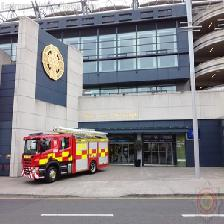

Actual: emergency, Predicted: emergency


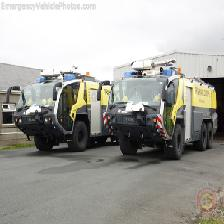

Actual: emergency, Predicted: emergency


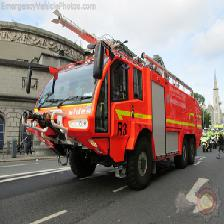

Actual: emergency, Predicted: emergency


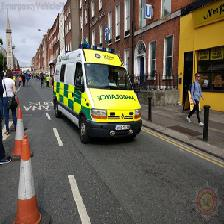

Actual: emergency, Predicted: emergency


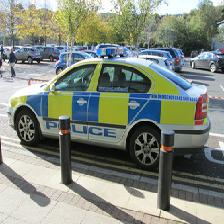

Actual: emergency, Predicted: emergency


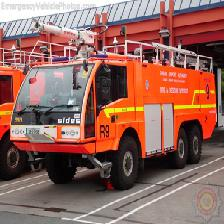

Actual: emergency, Predicted: emergency


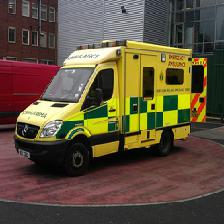

Actual: emergency, Predicted: emergency


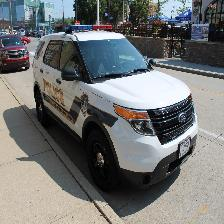

Actual: emergency, Predicted: emergency


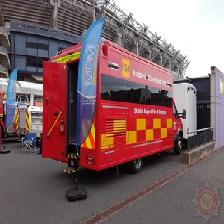

Actual: emergency, Predicted: emergency


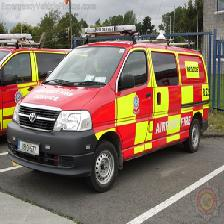

Actual: emergency, Predicted: emergency


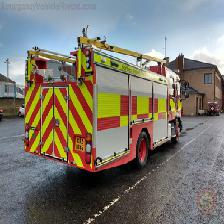

Actual: emergency, Predicted: emergency


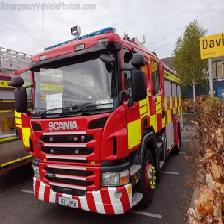

Actual: emergency, Predicted: emergency


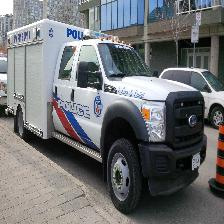

Actual: emergency, Predicted: emergency


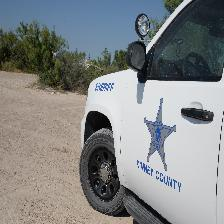

Actual: emergency, Predicted: emergency


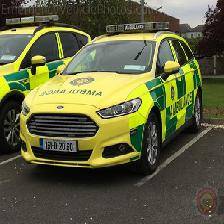

Actual: emergency, Predicted: emergency


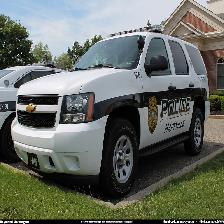

Actual: emergency, Predicted: emergency


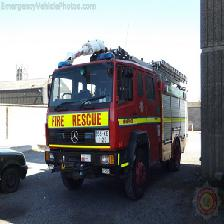

Actual: emergency, Predicted: emergency


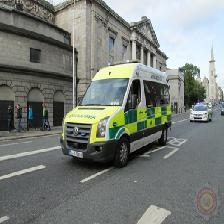

Actual: emergency, Predicted: emergency


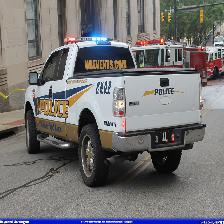

Actual: emergency, Predicted: emergency


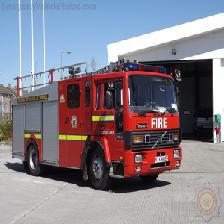

Actual: emergency, Predicted: emergency


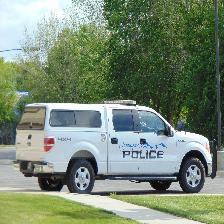

Actual: emergency, Predicted: emergency


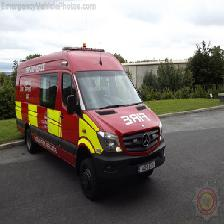

Actual: emergency, Predicted: emergency


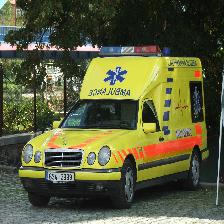

Actual: emergency, Predicted: emergency


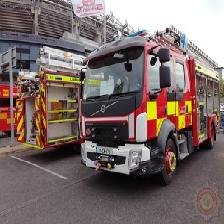

Actual: emergency, Predicted: emergency


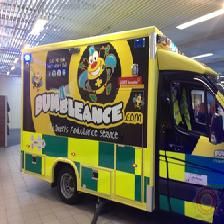

Actual: emergency, Predicted: emergency


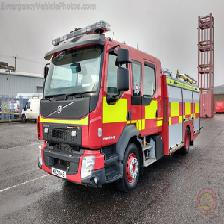

Actual: emergency, Predicted: emergency


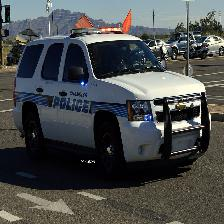

Actual: emergency, Predicted: emergency


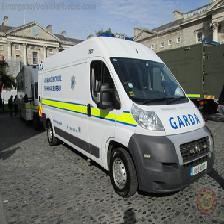

Actual: emergency, Predicted: emergency


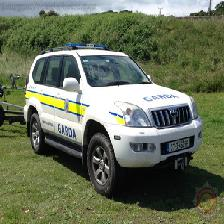

Actual: emergency, Predicted: emergency


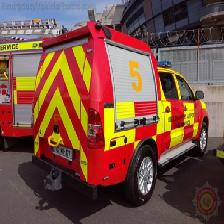

Actual: emergency, Predicted: emergency


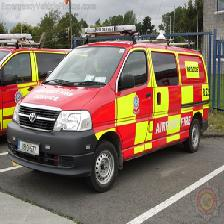

Actual: emergency, Predicted: emergency


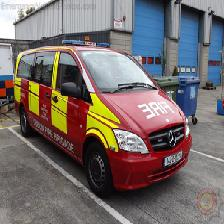

Actual: emergency, Predicted: emergency


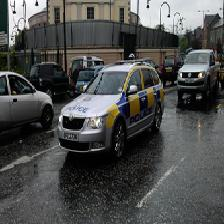

Actual: emergency, Predicted: emergency


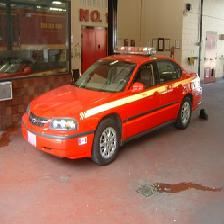

Actual: emergency, Predicted: emergency


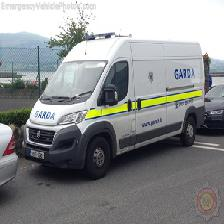

Actual: emergency, Predicted: emergency


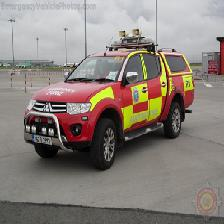

Actual: emergency, Predicted: emergency


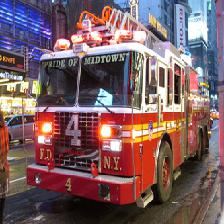

Actual: emergency, Predicted: emergency


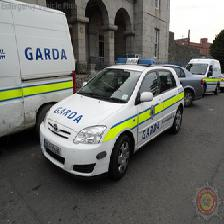

Actual: emergency, Predicted: emergency


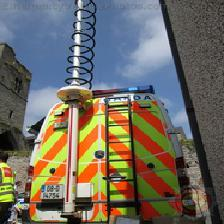

Actual: emergency, Predicted: emergency


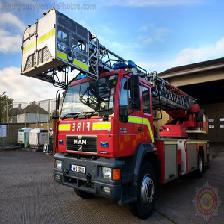

Actual: emergency, Predicted: emergency


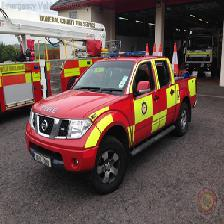

Actual: emergency, Predicted: emergency


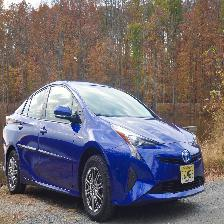

Actual: non_emergency, Predicted: non_emergency


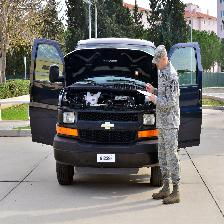

Actual: non_emergency, Predicted: non_emergency


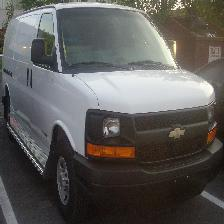

Actual: non_emergency, Predicted: non_emergency


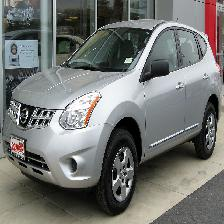

Actual: non_emergency, Predicted: non_emergency


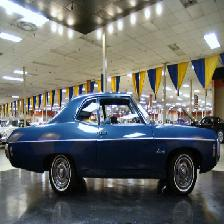

Actual: non_emergency, Predicted: non_emergency


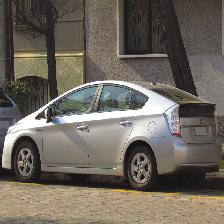

Actual: non_emergency, Predicted: non_emergency


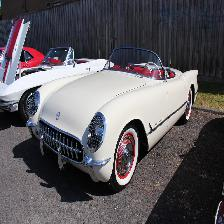

Actual: non_emergency, Predicted: non_emergency


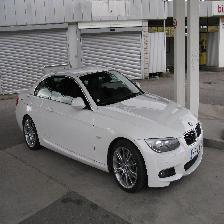

Actual: non_emergency, Predicted: non_emergency


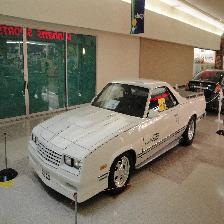

Actual: non_emergency, Predicted: non_emergency


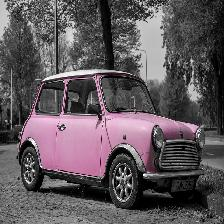

Actual: non_emergency, Predicted: non_emergency


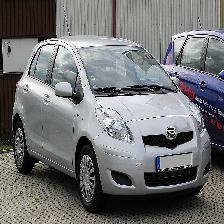

Actual: non_emergency, Predicted: non_emergency


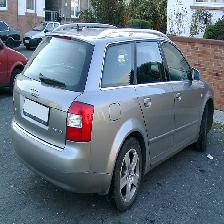

Actual: non_emergency, Predicted: non_emergency


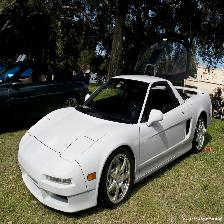

Actual: non_emergency, Predicted: non_emergency


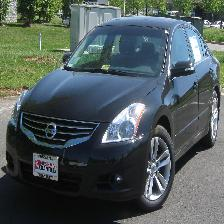

Actual: non_emergency, Predicted: non_emergency


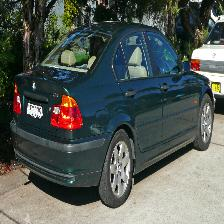

Actual: non_emergency, Predicted: non_emergency


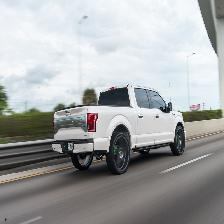

Actual: non_emergency, Predicted: non_emergency


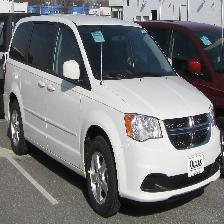

Actual: non_emergency, Predicted: non_emergency


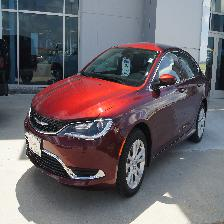

Actual: non_emergency, Predicted: non_emergency


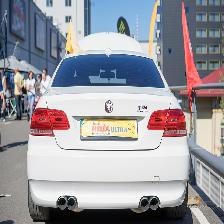

Actual: non_emergency, Predicted: non_emergency


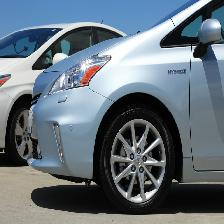

Actual: non_emergency, Predicted: non_emergency


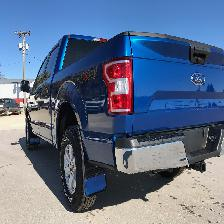

Actual: non_emergency, Predicted: non_emergency


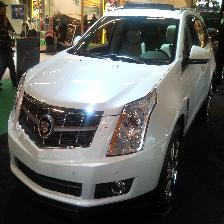

Actual: non_emergency, Predicted: non_emergency


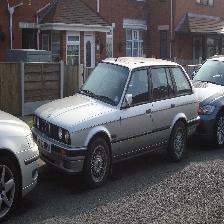

Actual: non_emergency, Predicted: non_emergency


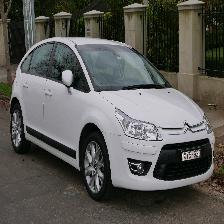

Actual: non_emergency, Predicted: non_emergency


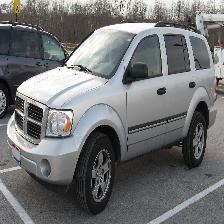

Actual: non_emergency, Predicted: non_emergency


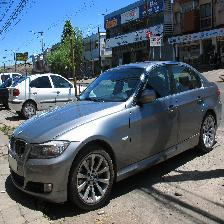

Actual: non_emergency, Predicted: non_emergency


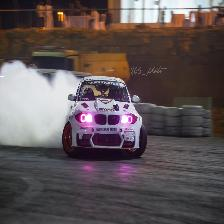

Actual: non_emergency, Predicted: non_emergency


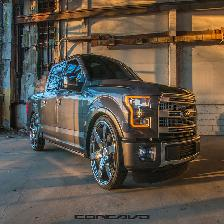

Actual: non_emergency, Predicted: non_emergency


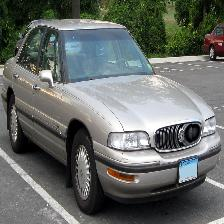

Actual: non_emergency, Predicted: non_emergency


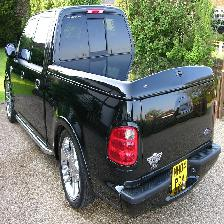

Actual: non_emergency, Predicted: non_emergency


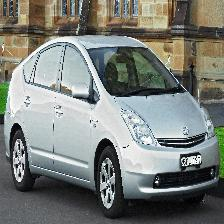

Actual: non_emergency, Predicted: non_emergency


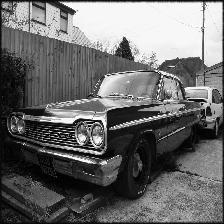

Actual: non_emergency, Predicted: non_emergency


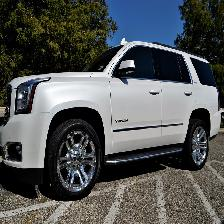

Actual: non_emergency, Predicted: non_emergency


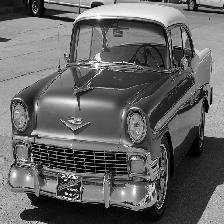

Actual: non_emergency, Predicted: non_emergency


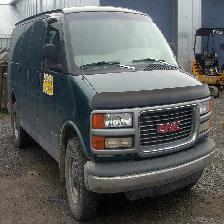

Actual: non_emergency, Predicted: non_emergency


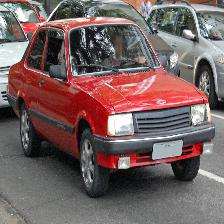

Actual: non_emergency, Predicted: non_emergency


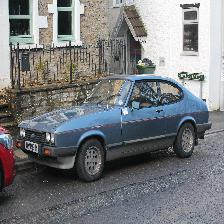

Actual: non_emergency, Predicted: non_emergency


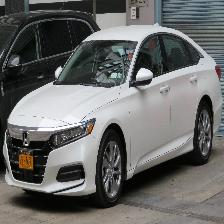

Actual: non_emergency, Predicted: non_emergency


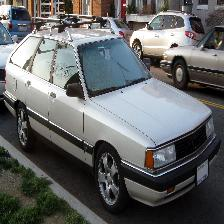

Actual: non_emergency, Predicted: non_emergency


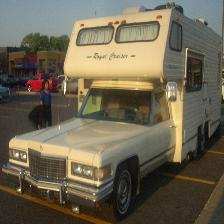

Actual: non_emergency, Predicted: non_emergency


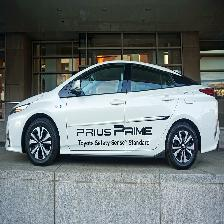

Actual: non_emergency, Predicted: non_emergency


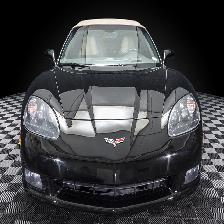

Actual: non_emergency, Predicted: non_emergency


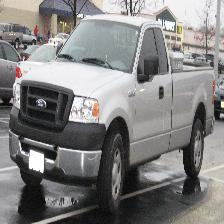

Actual: non_emergency, Predicted: non_emergency


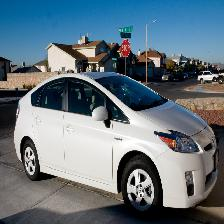

Actual: non_emergency, Predicted: non_emergency


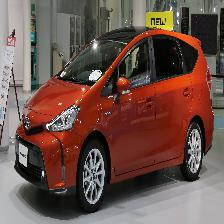

Actual: non_emergency, Predicted: non_emergency


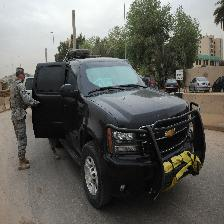

Actual: non_emergency, Predicted: non_emergency


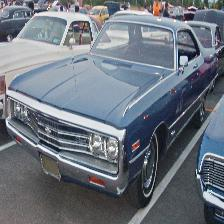

Actual: non_emergency, Predicted: non_emergency


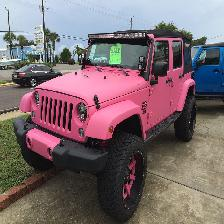

Actual: non_emergency, Predicted: non_emergency


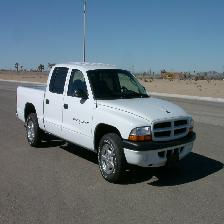

Actual: non_emergency, Predicted: non_emergency


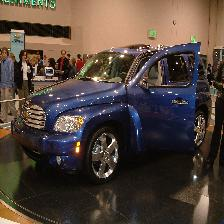

Actual: non_emergency, Predicted: non_emergency


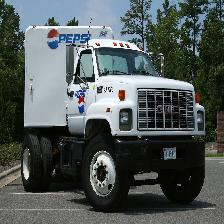

Actual: non_emergency, Predicted: non_emergency


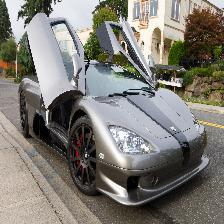

Actual: non_emergency, Predicted: non_emergency


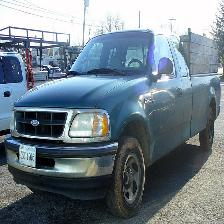

Actual: non_emergency, Predicted: non_emergency


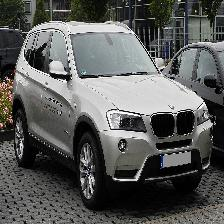

Actual: non_emergency, Predicted: non_emergency


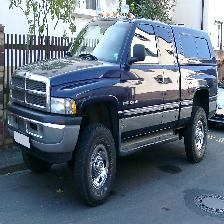

Actual: non_emergency, Predicted: non_emergency


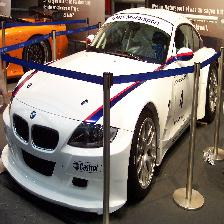

Actual: non_emergency, Predicted: non_emergency


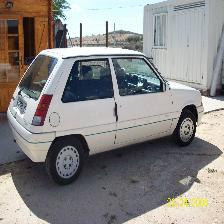

Actual: non_emergency, Predicted: non_emergency


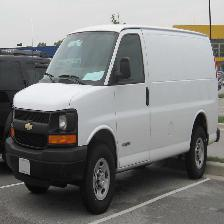

Actual: non_emergency, Predicted: non_emergency


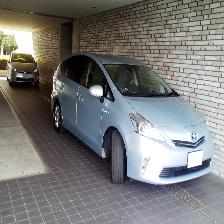

Actual: non_emergency, Predicted: non_emergency


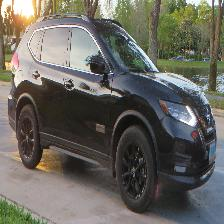

Actual: non_emergency, Predicted: non_emergency


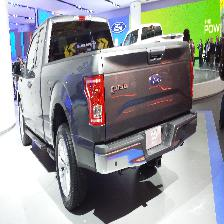

Actual: non_emergency, Predicted: non_emergency


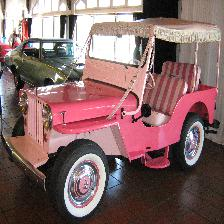

Actual: non_emergency, Predicted: non_emergency


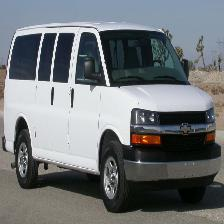

Actual: non_emergency, Predicted: non_emergency


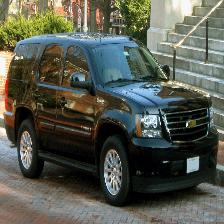

Actual: non_emergency, Predicted: non_emergency


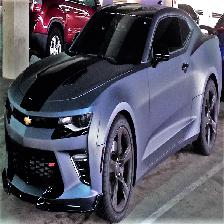

Actual: non_emergency, Predicted: non_emergency


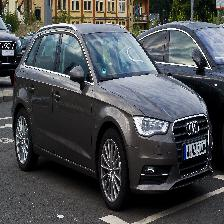

Actual: non_emergency, Predicted: non_emergency


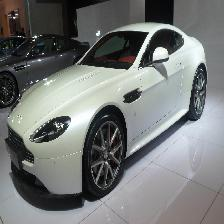

Actual: non_emergency, Predicted: non_emergency


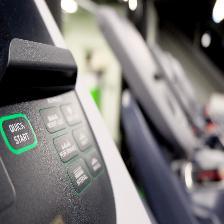

Actual: non_emergency, Predicted: non_emergency


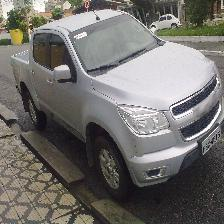

Actual: non_emergency, Predicted: non_emergency


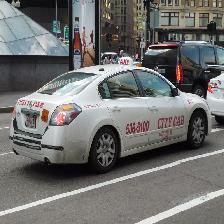

Actual: non_emergency, Predicted: non_emergency


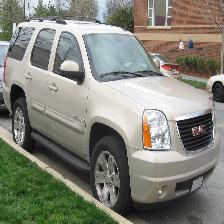

Actual: non_emergency, Predicted: non_emergency


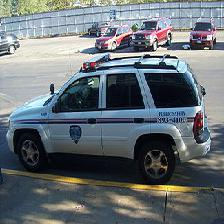

Actual: non_emergency, Predicted: non_emergency


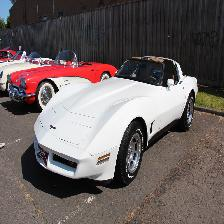

Actual: non_emergency, Predicted: non_emergency


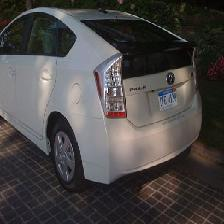

Actual: non_emergency, Predicted: non_emergency


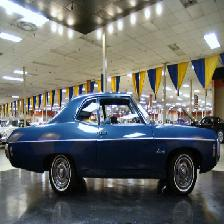

Actual: non_emergency, Predicted: non_emergency


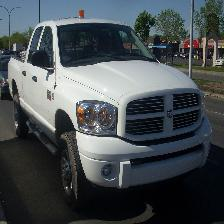

Actual: non_emergency, Predicted: non_emergency


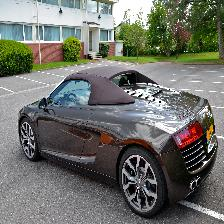

Actual: non_emergency, Predicted: non_emergency


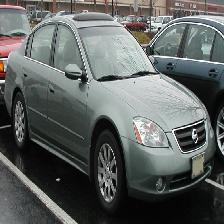

Actual: non_emergency, Predicted: non_emergency


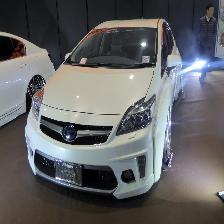

Actual: non_emergency, Predicted: non_emergency


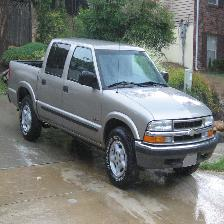

Actual: non_emergency, Predicted: non_emergency


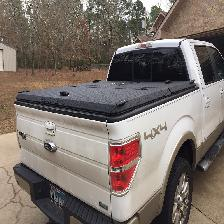

Actual: non_emergency, Predicted: non_emergency


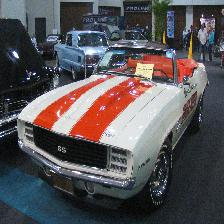

Actual: non_emergency, Predicted: non_emergency


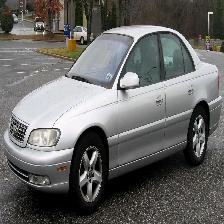

Actual: non_emergency, Predicted: non_emergency


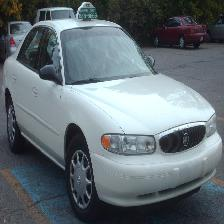

Actual: non_emergency, Predicted: non_emergency


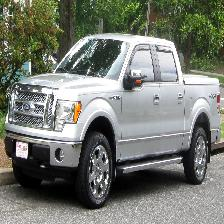

Actual: non_emergency, Predicted: non_emergency


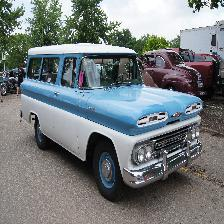

Actual: non_emergency, Predicted: non_emergency


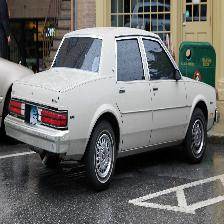

Actual: non_emergency, Predicted: non_emergency


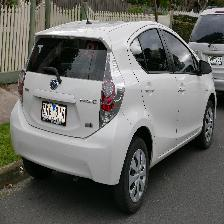

Actual: non_emergency, Predicted: non_emergency


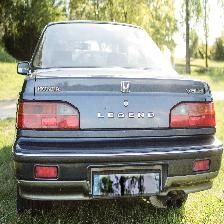

Actual: non_emergency, Predicted: non_emergency


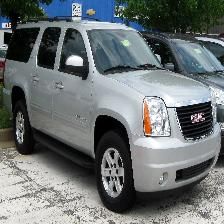

Actual: non_emergency, Predicted: non_emergency


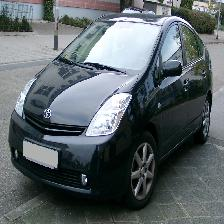

Actual: non_emergency, Predicted: non_emergency


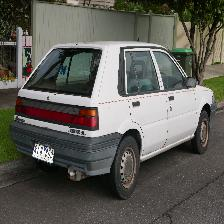

Actual: non_emergency, Predicted: non_emergency


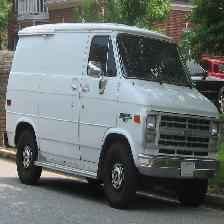

Actual: non_emergency, Predicted: non_emergency


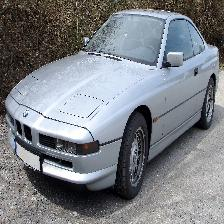

Actual: non_emergency, Predicted: non_emergency


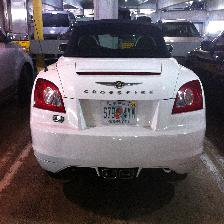

Actual: non_emergency, Predicted: non_emergency


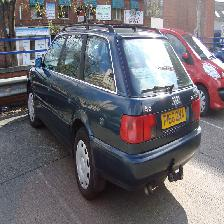

Actual: non_emergency, Predicted: non_emergency


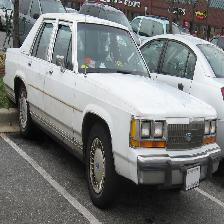

Actual: non_emergency, Predicted: non_emergency


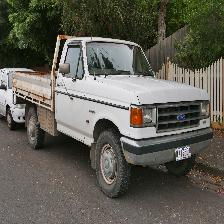

Actual: non_emergency, Predicted: non_emergency


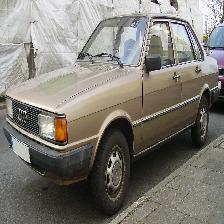

Actual: non_emergency, Predicted: non_emergency


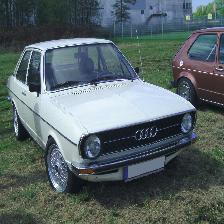

Actual: non_emergency, Predicted: non_emergency


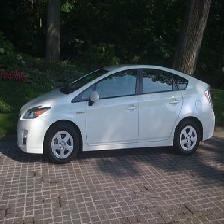

Actual: non_emergency, Predicted: non_emergency


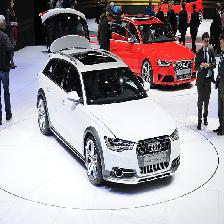

Actual: non_emergency, Predicted: non_emergency


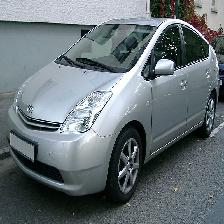

Actual: non_emergency, Predicted: non_emergency


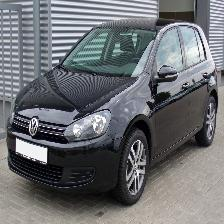

Actual: non_emergency, Predicted: non_emergency


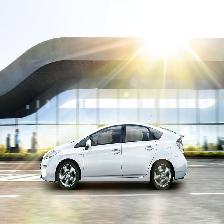

Actual: non_emergency, Predicted: non_emergency


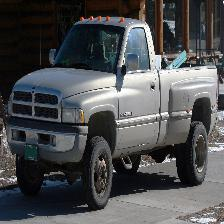

Actual: non_emergency, Predicted: non_emergency


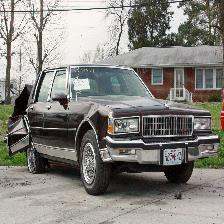

Actual: non_emergency, Predicted: non_emergency


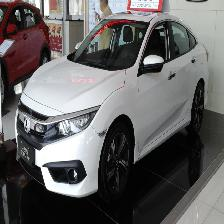

Actual: non_emergency, Predicted: non_emergency


In [ ]:
from google.colab.patches import cv2_imshow
for imge,label in zip(correct_images,correct_labels):
  cv2_imshow(imge)
  print('Actual: {}, Predicted: {}'.format(labels[int(label[0])], labels[int(label[1])]))

In [ ]:
incorrect_images = []
incorrect_labels = []
for i, (true, pred) in enumerate(zip(val_true, val_pred)):
  if true != pred:
    img = cv2.imread(f'/content/drive/MyDrive/masterfolder/validation/{val_files[i]}')
    incorrect_images.append(img)
    incorrect_labels.append([true, pred])

incorrect_images = np.array(incorrect_images)
incorrect_images.shape

(124, 224, 224, 3)

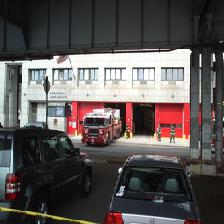

Actual: emergency, Predicted: non_emergency


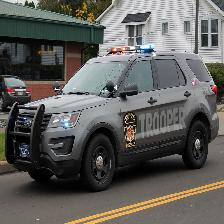

Actual: emergency, Predicted: non_emergency


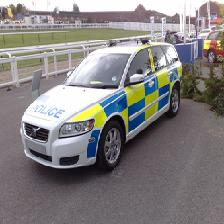

Actual: emergency, Predicted: non_emergency


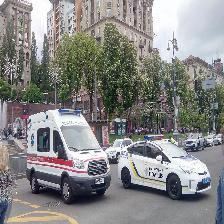

Actual: emergency, Predicted: non_emergency


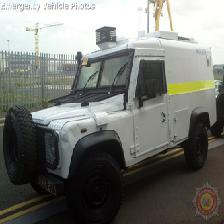

Actual: emergency, Predicted: non_emergency


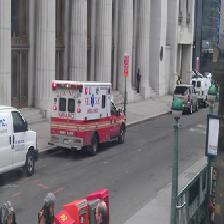

Actual: emergency, Predicted: non_emergency


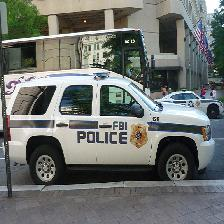

Actual: emergency, Predicted: non_emergency


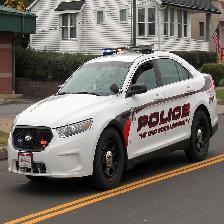

Actual: emergency, Predicted: non_emergency


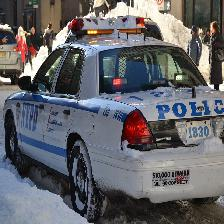

Actual: emergency, Predicted: non_emergency


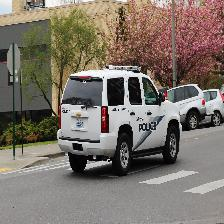

Actual: emergency, Predicted: non_emergency


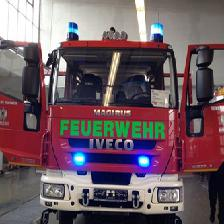

Actual: emergency, Predicted: non_emergency


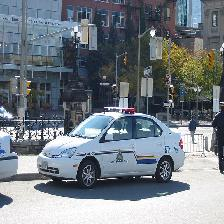

Actual: emergency, Predicted: non_emergency


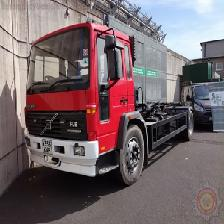

Actual: emergency, Predicted: non_emergency


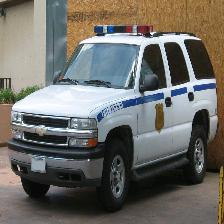

Actual: emergency, Predicted: non_emergency


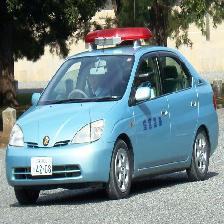

Actual: emergency, Predicted: non_emergency


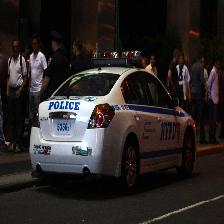

Actual: emergency, Predicted: non_emergency


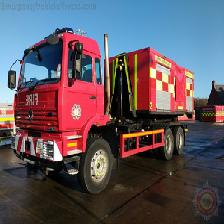

Actual: emergency, Predicted: non_emergency


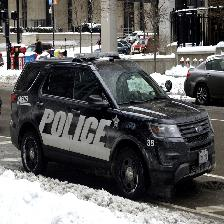

Actual: emergency, Predicted: non_emergency


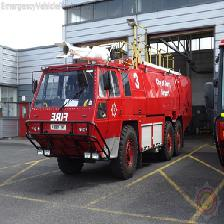

Actual: emergency, Predicted: non_emergency


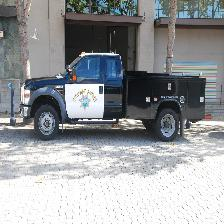

Actual: emergency, Predicted: non_emergency


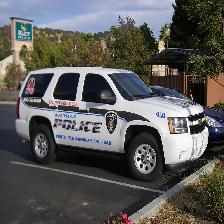

Actual: emergency, Predicted: non_emergency


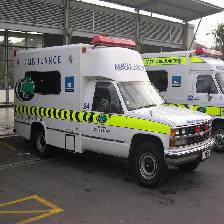

Actual: emergency, Predicted: non_emergency


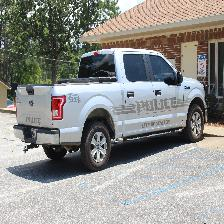

Actual: emergency, Predicted: non_emergency


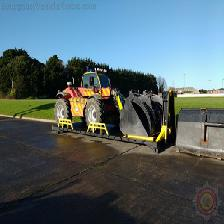

Actual: emergency, Predicted: non_emergency


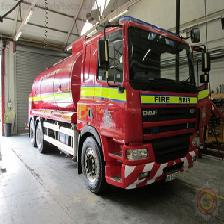

Actual: emergency, Predicted: non_emergency


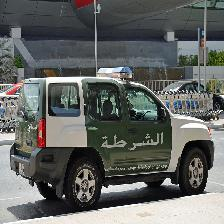

Actual: emergency, Predicted: non_emergency


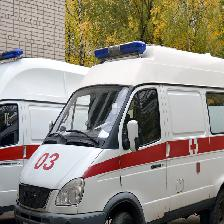

Actual: emergency, Predicted: non_emergency


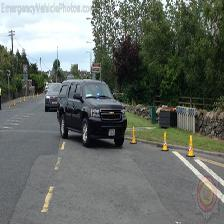

Actual: emergency, Predicted: non_emergency


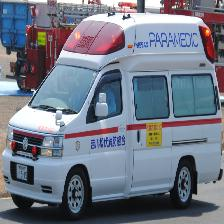

Actual: emergency, Predicted: non_emergency


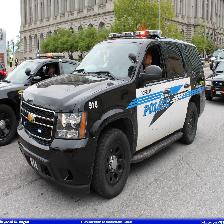

Actual: emergency, Predicted: non_emergency


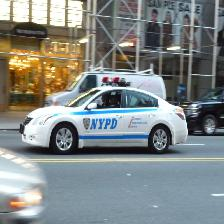

Actual: emergency, Predicted: non_emergency


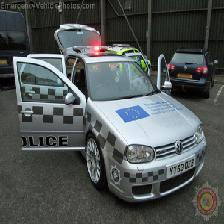

Actual: emergency, Predicted: non_emergency


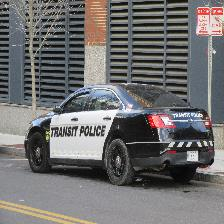

Actual: emergency, Predicted: non_emergency


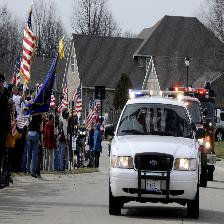

Actual: emergency, Predicted: non_emergency


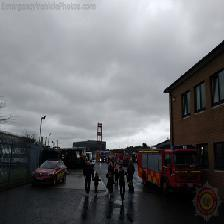

Actual: emergency, Predicted: non_emergency


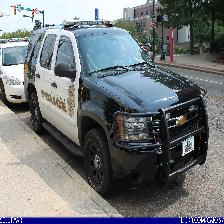

Actual: emergency, Predicted: non_emergency


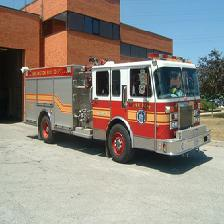

Actual: emergency, Predicted: non_emergency


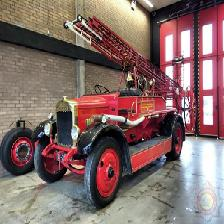

Actual: emergency, Predicted: non_emergency


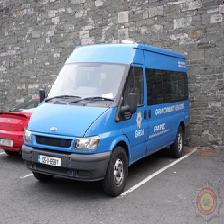

Actual: emergency, Predicted: non_emergency


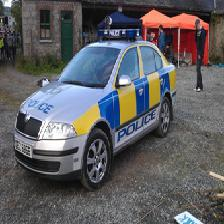

Actual: emergency, Predicted: non_emergency


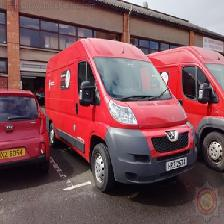

Actual: emergency, Predicted: non_emergency


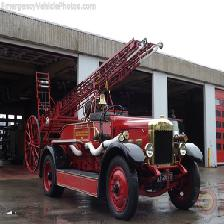

Actual: emergency, Predicted: non_emergency


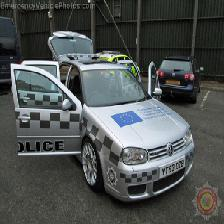

Actual: emergency, Predicted: non_emergency


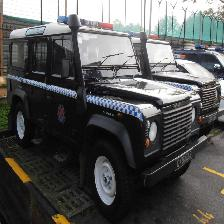

Actual: emergency, Predicted: non_emergency


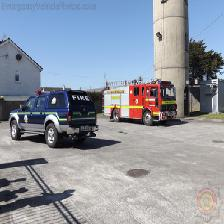

Actual: emergency, Predicted: non_emergency


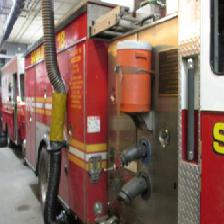

Actual: emergency, Predicted: non_emergency


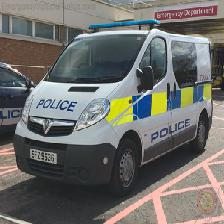

Actual: emergency, Predicted: non_emergency


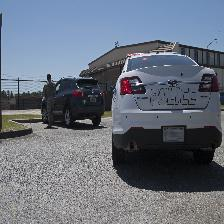

Actual: emergency, Predicted: non_emergency


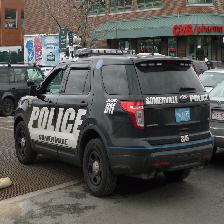

Actual: emergency, Predicted: non_emergency


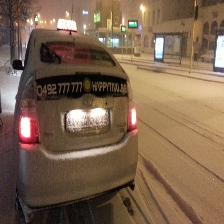

Actual: non_emergency, Predicted: emergency


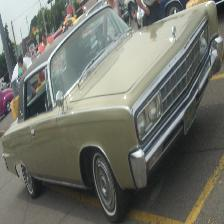

Actual: non_emergency, Predicted: emergency


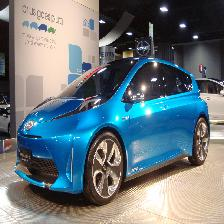

Actual: non_emergency, Predicted: emergency


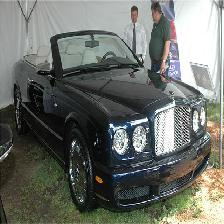

Actual: non_emergency, Predicted: emergency


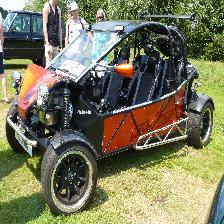

Actual: non_emergency, Predicted: emergency


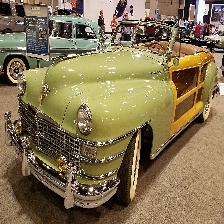

Actual: non_emergency, Predicted: emergency


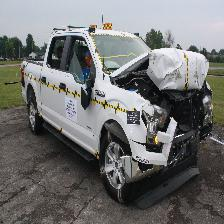

Actual: non_emergency, Predicted: emergency


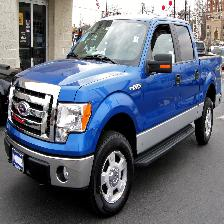

Actual: non_emergency, Predicted: emergency


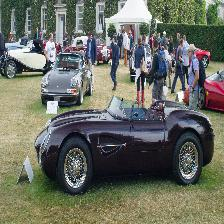

Actual: non_emergency, Predicted: emergency


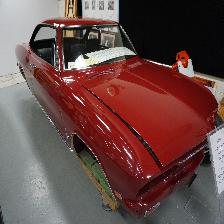

Actual: non_emergency, Predicted: emergency


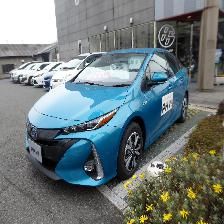

Actual: non_emergency, Predicted: emergency


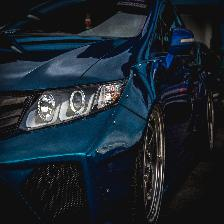

Actual: non_emergency, Predicted: emergency


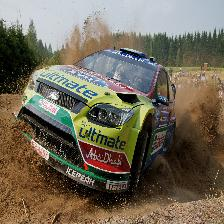

Actual: non_emergency, Predicted: emergency


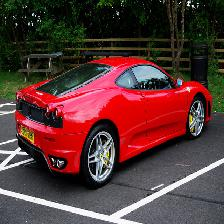

Actual: non_emergency, Predicted: emergency


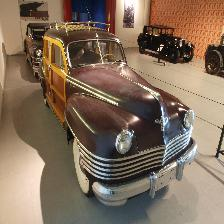

Actual: non_emergency, Predicted: emergency


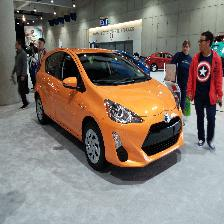

Actual: non_emergency, Predicted: emergency


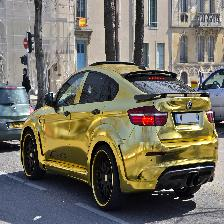

Actual: non_emergency, Predicted: emergency


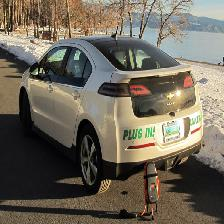

Actual: non_emergency, Predicted: emergency


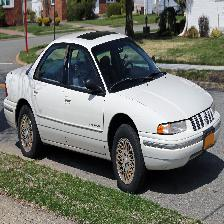

Actual: non_emergency, Predicted: emergency


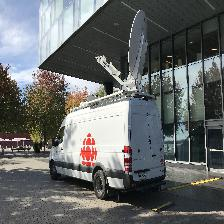

Actual: non_emergency, Predicted: emergency


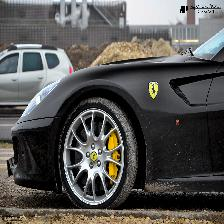

Actual: non_emergency, Predicted: emergency


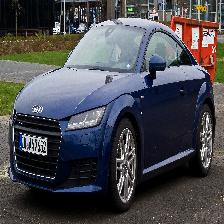

Actual: non_emergency, Predicted: emergency


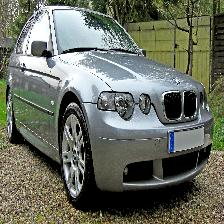

Actual: non_emergency, Predicted: emergency


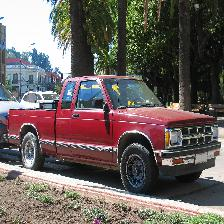

Actual: non_emergency, Predicted: emergency


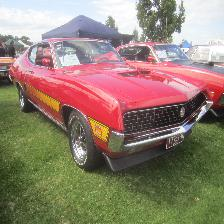

Actual: non_emergency, Predicted: emergency


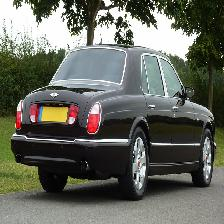

Actual: non_emergency, Predicted: emergency


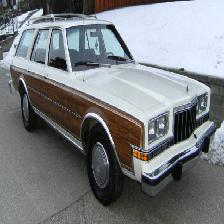

Actual: non_emergency, Predicted: emergency


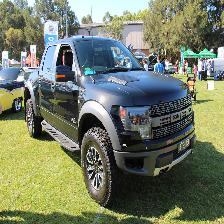

Actual: non_emergency, Predicted: emergency


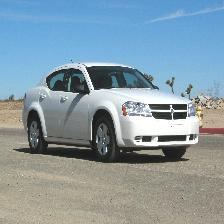

Actual: non_emergency, Predicted: emergency


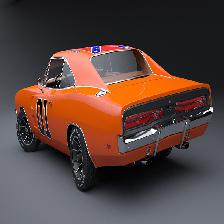

Actual: non_emergency, Predicted: emergency


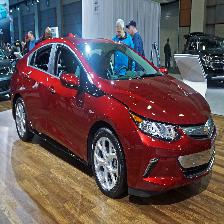

Actual: non_emergency, Predicted: emergency


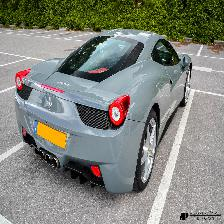

Actual: non_emergency, Predicted: emergency


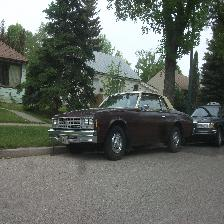

Actual: non_emergency, Predicted: emergency


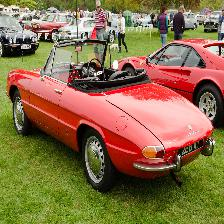

Actual: non_emergency, Predicted: emergency


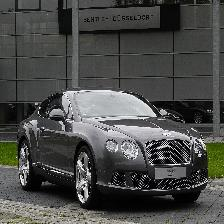

Actual: non_emergency, Predicted: emergency


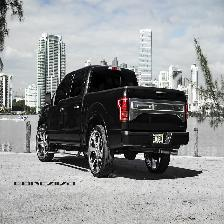

Actual: non_emergency, Predicted: emergency


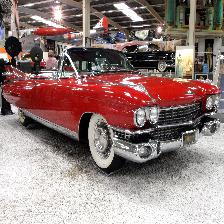

Actual: non_emergency, Predicted: emergency


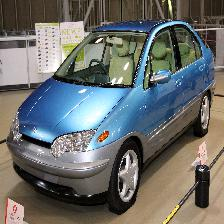

Actual: non_emergency, Predicted: emergency


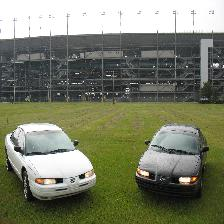

Actual: non_emergency, Predicted: emergency


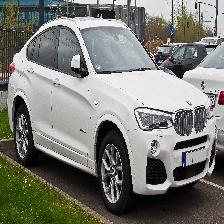

Actual: non_emergency, Predicted: emergency


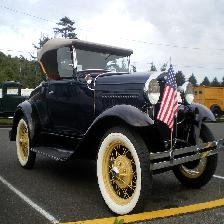

Actual: non_emergency, Predicted: emergency


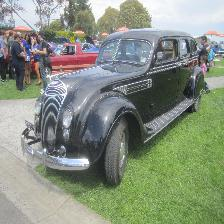

Actual: non_emergency, Predicted: emergency


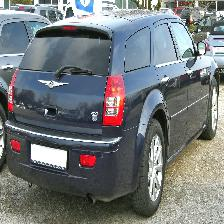

Actual: non_emergency, Predicted: emergency


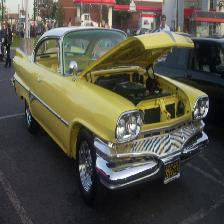

Actual: non_emergency, Predicted: emergency


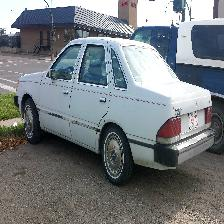

Actual: non_emergency, Predicted: emergency


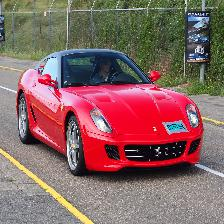

Actual: non_emergency, Predicted: emergency


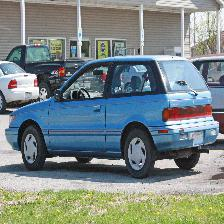

Actual: non_emergency, Predicted: emergency


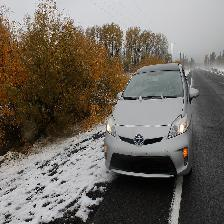

Actual: non_emergency, Predicted: emergency


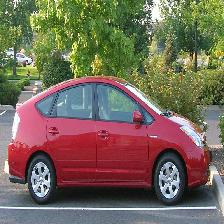

Actual: non_emergency, Predicted: emergency


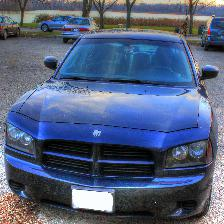

Actual: non_emergency, Predicted: emergency


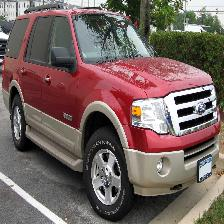

Actual: non_emergency, Predicted: emergency


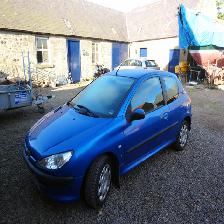

Actual: non_emergency, Predicted: emergency


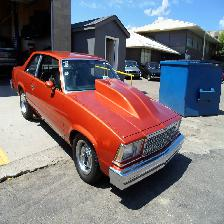

Actual: non_emergency, Predicted: emergency


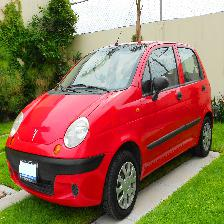

Actual: non_emergency, Predicted: emergency


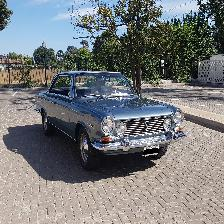

Actual: non_emergency, Predicted: emergency


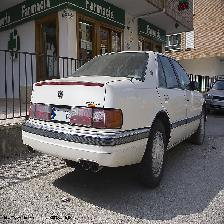

Actual: non_emergency, Predicted: emergency


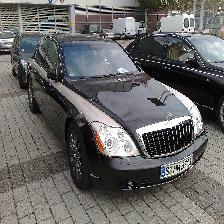

Actual: non_emergency, Predicted: emergency


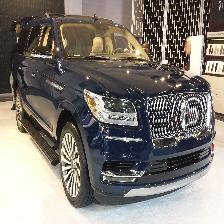

Actual: non_emergency, Predicted: emergency


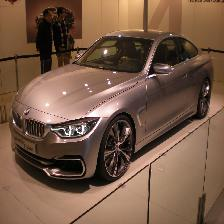

Actual: non_emergency, Predicted: emergency


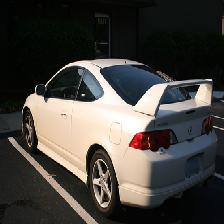

Actual: non_emergency, Predicted: emergency


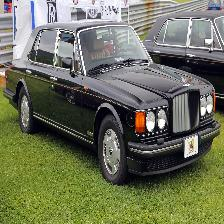

Actual: non_emergency, Predicted: emergency


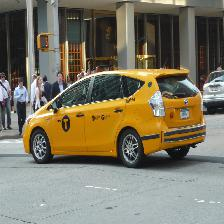

Actual: non_emergency, Predicted: emergency


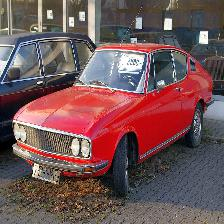

Actual: non_emergency, Predicted: emergency


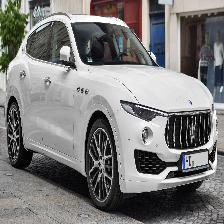

Actual: non_emergency, Predicted: emergency


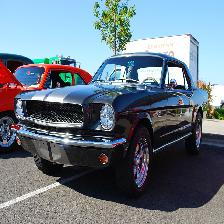

Actual: non_emergency, Predicted: emergency


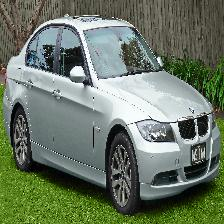

Actual: non_emergency, Predicted: emergency


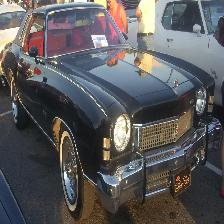

Actual: non_emergency, Predicted: emergency


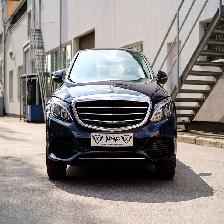

Actual: non_emergency, Predicted: emergency


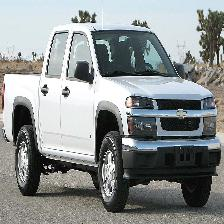

Actual: non_emergency, Predicted: emergency


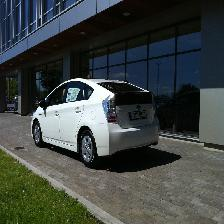

Actual: non_emergency, Predicted: emergency


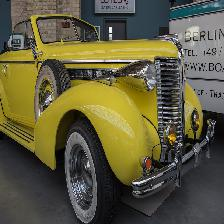

Actual: non_emergency, Predicted: emergency


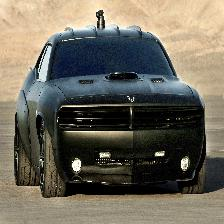

Actual: non_emergency, Predicted: emergency


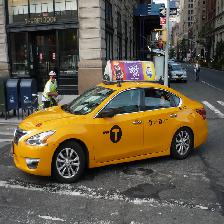

Actual: non_emergency, Predicted: emergency


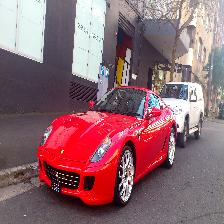

Actual: non_emergency, Predicted: emergency


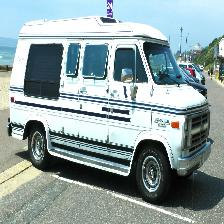

Actual: non_emergency, Predicted: emergency


In [ ]:
from google.colab.patches import cv2_imshow
for imag,label in zip(incorrect_images, incorrect_labels):
  cv2_imshow(imag)
  print('Actual: {}, Predicted: {}'.format(labels[int(label[0])], labels[int(label[1])]))

In [ ]:
# dir_path="/content/drive/MyDrive/masterfolder/test"

# for i in os.listdir(dir_path):
#   img=image.load_img(dir_path+'//'+ i,target_size=(224,224))  # // used to read the data
#   plt.imshow(img)
#   plt.show()

#   x=image.img_to_array(img)
#   x=np.expand_dims(x,axis=0)
#   images=np.vstack([x])
#   val=model.predict(images)
#   print()
#   if val==0:
#     print("This is an emergency vehicle")
#   else:
#     print("ordinary")